In [1]:
import pandas as pd
import numpy as np
import requests
from bs4 import BeautifulSoup
import matplotlib.pyplot as plt
from pathlib import Path
from shapely import MultiPoint, Point,MultiPolygon,unary_union
# from shapely.ops import clip_by_rect
import geopandas as gpd
import folium
# from itertools import pairwise
from pyroutelib3 import find_route, haversine_earth_distance
import pyroutelib3

from tqdm import tqdm
# from random import shuffle
import json
# from descartes import PolygonPatch
%matplotlib qt

qt.qpa.plugin: Could not find the Qt platform plugin "wayland" in ""


In [2]:
base_url = 'https://en.wikipedia.org'
station_file_path = Path('./stations.json')

def get_coords(link):
  r = requests.get(base_url + link)
  soup = BeautifulSoup(r.text, 'html.parser')
  coordstring = soup.find(class_="geo").text.strip()
  tuplestring = tuple(map(float, coordstring.split(';')))
  return (tuplestring[1], tuplestring[0])

if station_file_path.exists():
  stations = pd.read_json(station_file_path)
else:
  url = "https://en.wikipedia.org/wiki/List_of_Montreal_Metro_stations"
  stations = pd.read_html(url)[1]
  response = requests.get(url)
  soup = BeautifulSoup(response.text, 'html.parser')
  table = soup.find_all('table')[1]
  links = []
  for tr in table.findAll("tr"):
    trs = tr.findAll("th")
    for each in trs:
      try:
        link = each.find('a')['href']
        links.append(link)
      except:
        pass
  stations['Link']=links[1:]
  stations['coords'] = stations['Link'].apply(get_coords)
  stations.to_json(station_file_path)


In [3]:
# Fudge U-de-M station coordinates to fix bad pathing.
stations.loc[59,'coords'][0] = -73.618284
stations.loc[59,'coords'][1] = 45.502786
# Fudge C-D-N station coordinates as well.
stations.loc[58,'coords'][0] = -73.623385
stations.loc[58,'coords'][1] = 45.496800


In [29]:
stations

,Name,Odonym,Namesake,Line,Accessible,Opened,Link,coords,node,node_coord,color,color2,color3
0,Angrignon,Boulevard Angrignon; Parc Angrignon,"Jean-Baptiste Angrignon, city councillor",NaN,Yes (2022),3 Sep 1978,/wiki/Angrignon_station,"[-73.60361, 45.44611]",9870117252,"(45.446084600000006, -73.6037687)",green,NaN,NaN
1,Monk,Boulevard Monk,"James Monk, Quebec Attorney-General",NaN,None,3 Sep 1978,/wiki/Monk_station,"[-73.59306, 45.45139]",7126674189,"(45.451320700000004, -73.5929954)",green,NaN,NaN
2,Jolicoeur,Rue Jolicoeur,"Jean-Moïse Jolicoeur, parish priest",NaN,Yes (2022),3 Sep 1978,/wiki/Jolicoeur_station,"[-73.58194, 45.45667]",6133354097,"(45.456633200000006, -73.5817921)",green,NaN,NaN
3,Verdun,Rue de Verdun; borough of Verdun,"Notre-Dame-de-Saverdun, France, hometown of Se...",NaN,None,3 Sep 1978,/wiki/Verdun_station,"[-73.57167, 45.45944]",7137038985,"(45.4594916, -73.57166260000001)",green,NaN,NaN
4,De L'Église,Avenue de l'Église,Église Saint-Paul,NaN,None,3 Sep 1978,/wiki/De_L%27%C3%89glise_station,"[-73.56694, 45.46278]",1764284111,"(45.4627865, -73.5670118)",green,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
63,Parc,Avenue du Parc,Mount Royal Park,NaN,None,15 Jun 1987,/wiki/Parc_station_(Montreal),"[-73.6237, 45.5305]",4303510521,"(45.5304732, -73.62353660000001)",blue,NaN,NaN
64,De Castelnau,Rue de Castelnau,"Édouard de Castelnau, French soldier",NaN,None,16 Jun 1986,/wiki/De_Castelnau_station,"[-73.62, 45.53528]",7757321592,"(45.5353277, -73.6199684)",blue,NaN,NaN
65,Fabre,Rue Fabre,"Édouard-Charles Fabre, first Roman Catholic Bi...",NaN,None,16 Jun 1986,/wiki/Fabre_station,"[-73.60722, 45.54778]",9409002877,"(45.547834800000004, -73.6071493)",blue,NaN,NaN
66,D'Iberville,Rue d'Iberville,"Pierre Le Moyne d'Iberville, Quebec explorer, ...",NaN,None,16 Jun 1986,/wiki/D%27Iberville_station,"[-73.60194, 45.55361]",437697295,"(45.553635400000005, -73.6020376)",blue,NaN,NaN


In [5]:
# Downloaded from https://download.bbbike.org/osm/bbbike/Montreal/
with open('montreal_canada.osm.pbf', "rb") as f:
    graph = pyroutelib3.osm.Graph.from_file(pyroutelib3.osm.FootProfile(), f)

# This one is a lot bigger so much slower to work with initally
# # Downloaded from https://download.geofabrik.de/north-america/canada/quebec.html
# with open('quebec-latest.osm.pbf', "rb") as f:
#     graph = pyroutelib3.osm.Graph.from_file(pyroutelib3.osm.FootProfile(), f)

In [6]:
nodes = list(map(lambda x: graph.find_nearest_node(x[::-1]),stations['coords']))

In [7]:
stations['node'] = list(map(lambda x: x.id, nodes))
stations['node_coord'] = list(map(lambda x: x.position, nodes))

In [8]:
# Set the line colour of each station
stations.loc[:26,'color'] = 'green'
stations.loc[27:55, 'color'] = 'orange'
stations.loc[56:57, 'color'] = 'yellow'
stations.loc[58:,'color'] = 'blue'

stations.loc[stations[stations['Name'] == 'Berri–UQAM formerly Berri-de Montigny'].index[0],'color2'] = 'orange'
stations.loc[stations[stations['Name'] == 'Berri–UQAM formerly Berri-de Montigny'].index[0],'color3'] = 'yellow'
stations.loc[stations[stations['Name'] == 'Lionel-Groulx'].index[0],'color2'] = 'orange'
stations.loc[stations[stations['Name'] == 'Snowdon'].index[0],'color2'] = 'blue'
stations.loc[stations[stations['Name'] == 'Jean-Talon'].index[0],'color2'] = 'blue'

In [9]:
# Defining an area of interest based of a roughly rectangular cut of the
# montreal area
canada = gpd.read_file('./lpr_000b16a_e.shp')
canada = canada.to_crs('WGS84')
quebec = canada[canada['PRENAME'] == 'Quebec']
quebecgeo = quebec.iloc[0]['geometry']

montreal_lat_lon = (45.514822,-73.582458)
laval_lat_lon = (45.598240,-73.729057)
st_helen_lat_lon = (45.520175,-73.534865)
notre_dame_lat_lon = (45.506991, -73.527333)
longueil_lat_lon = (45.526791, -73.512384)
lat_longs = [montreal_lat_lon,laval_lat_lon,st_helen_lat_lon,notre_dame_lat_lon,longueil_lat_lon]
polygons = []
for lat,lon in lat_longs:
    for poly in quebecgeo.geoms:
        if poly.contains(Point(lon,lat)):
            polygons.append(poly)
islands = MultiPolygon(polygons)

lonmin = -73.75576009950493
lonmax = -73.49785410632529
latmin = 45.412574863304734
latmax = 45.63855628356792
rect = MultiPoint([(lonmin,latmin),(lonmax,latmax)]).envelope
montrealgeo = quebecgeo.intersection(rect)
islands = islands.intersection(rect)

area = montrealgeo.convex_hull

ERROR 1: PROJ: proj_create_from_database: Open of /opt/micromamba/envs/metromap/share/proj failed


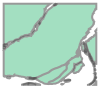

In [10]:
montrealgeo

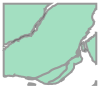

In [11]:
islands

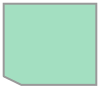

In [12]:
area

In [36]:
# Plot the area with the metro stations and their nearest nodes
fig, ax = plt.subplots(figsize=(12,12))
quebec.plot(ax=ax)
ax.set_xlim(lonmin,lonmax)
ax.set_ylim(latmin,latmax)

errors = []

for i in range(len(stations)):
  d = stations.iloc[i]
  cds = d['coords']
  ncds = d['node_coord']
  ax.plot(cds[0], cds[1],  marker='o', markersize=8,color='C1', zorder=10)
  ax.plot(ncds[1], ncds[0],  marker='o', markersize=8,color='C2', zorder=10)
  errors.append(haversine_earth_distance(cds[::-1],ncds))
print(f"Maximum offset is: {max(errors)*1000:.2f}m")

plt.show()

Maximum offset is: 32.79m


In [14]:
# Plot the area of interest with all the location nodes we have
fig, ax = plt.subplots(figsize=(12,12))
quebec.plot(ax=ax)
ax.set_xlim(lonmin,lonmax)
ax.set_ylim(latmin,latmax)

lats = []
longs = [] 
for n,node in graph.nodes.items():
  lats.append(node.position[0])
  longs.append(node.position[1])
  
ax.scatter(longs, lats,  marker='o', s=8,color='C2', zorder=10)

plt.show()

In [37]:
# All together now
fig, ax = plt.subplots(figsize=(12,12))
quebec.plot(ax=ax)
ax.set_xlim(-73.75,-73.472)
ax.set_ylim(45.398,45.623)

lats = []
longs = [] 
for n,node in graph.nodes.items():
  lats.append(node.position[0])
  longs.append(node.position[1])
  
ax.scatter(longs, lats,  marker='o', s=8,color='C3', zorder=10)

lats = []
longs = [] 
# for n in node_stations.keys():
#   loc = router.nodeLatLon(n)
for loc in stations['node_coord']:
  lats.append(loc[0])
  longs.append(loc[1])
  
ax.scatter(longs, lats,  marker='o', s=8,color='C2', zorder=10)

plt.show()

In [38]:
len(graph.nodes)

1805516

In [17]:
s_n_dict = dict(zip(stations['Name'].to_list(),stations['node'].to_list()))
s_n = list(s_n_dict.keys())
filename = "./flood_nodes_old_data_new_api.json"
nodes_file = Path(filename)
if nodes_file.exists():
    with nodes_file.open('r') as f:
        node_stations = json.load(f)
    for key in list(node_stations.keys()):
        node_stations[int(key)] = node_stations.pop(key)
else:
    node_stations = {n:['',np.inf] for n in tqdm(graph.nodes) if area.contains(Point(graph.get_node(n).position[::-1]))}
    for name,node in s_n_dict.items():
        node_stations[node] = (name,0) 
    queues = {n:[(s_n_dict[n],node,0) for node in graph.edges[s_n_dict[n]].keys() if node in node_stations.keys()] for n in s_n}
    iters = 0
    # While there's still stations processing
    while len(s_n) > 0:
        print(iters, len(s_n), sum([len(queue) for queue in queues.values()]))
        # Loop over each station
        for i,name in enumerate(s_n):
            # Remove from processing if it has no more elements
            if len(queues[name]) == 0:
                print(s_n.pop(i))
            else:
                queues[name] = sorted(queues[name],key=lambda x: x[2])
                # Get current length of queue to process
                queue_len = len(queues[name])
                # For each element in queue
                for _ in range(queue_len):
                    # Remove element
                    old_node,new_node,distance = queues[name].pop(0)
                    # Update the total distance to this node
                    total_distance = distance + graph.edges.get(old_node,{}).get(new_node,np.inf)
                    # If the total distance is shorter then currently stored, update it
                    if total_distance < node_stations[new_node][1]:
                        node_stations[new_node] = (name,total_distance)
                        # Then, add each of this nodes neighbours to the queue for consideration
                        # except for the node we're currently at, and any outside of our exclusion zone
                        for node in graph.edges.get(new_node,{}).keys():
                            if node != old_node and node in node_stations.keys():
                                queues[name].append((new_node,node,total_distance))
        iters += 1
    with nodes_file.open('w') as f:
        json.dump(node_stations,f)

100%|██████████| 1805516/1805516 [00:25<00:00, 70383.99it/s]


0 68 170
1 68 329
2 68 599
3 68 921
4 68 1329
5 68 1770
6 68 2391
7 68 3127
8 68 4034
9 68 4918
10 68 6010
11 68 7170
12 68 8484
13 68 9912
14 68 11407
15 68 13132
16 68 14868
17 68 16554
18 68 18319
19 68 20141
20 68 22285
21 68 24536
22 68 26723
23 68 29190
24 68 31538
25 68 33670
26 68 35698
27 68 37796
28 68 39693
29 68 41419
30 68 43002
31 68 44595
32 68 46246
33 68 47849
34 68 49046
35 68 50337
36 68 51559
37 68 52971
38 68 54086
39 68 55028
40 68 55920
41 68 56948
42 68 57683
43 68 58464
44 68 58947
45 68 59541
46 68 60026
47 68 60310
48 68 60751
49 68 61244
50 68 61585
51 68 62009
52 68 62814
53 68 63139
54 68 63412
Saint-Laurent
55 67 63701
Beaudry
56 66 63995
57 66 64408
58 66 64416
59 66 64664
Papineau
60 65 64898
61 65 64853
62 65 64948
63 65 65196
Lionel-Groulx
64 64 65446
65 64 65632
66 64 65931
67 64 66218
68 64 66530
69 64 66877
70 64 66930
71 64 67207
72 64 67595
73 64 68177
74 64 68586
Joliette
De Castelnau
75 62 68969
76 62 69349
77 62 69705
78 62 69972
Parc
79 61 70

In [39]:
fig, ax = plt.subplots(figsize=(12,12))
quebec.plot(ax=ax,color='gray')
ax.set_xlim(-73.75,-73.472)
ax.set_ylim(45.398,45.623)
from cycler import cycler
dc = cycler(color=['#E8ECFB', '#D9CCE3', '#D1BBD7', '#CAACCB', '#BA8DB4', '#AE76A3', 
                   '#AA6F9E', '#994F88', '#882E72', '#1965B0', '#437DBF', '#5289C7', 
                   '#6195CF', '#7BAFDE', '#4EB265', '#90C987', '#CAE0AB', '#F7F056', 
                   '#F7CB45', '#F6C141', '#F4A736', '#F1932D', '#EE8026', '#E8601C', 
                   '#E65518', '#DC050C', '#A5170E', '#72190E', '#42150A'])
names = s_n_dict.keys()
ax.set_prop_cycle(dc)
for name in names:
    lats = []
    longs = [] 
    for n in node_stations.keys():
        if node_stations[n][0] == name:
            loc = graph.get_node(n).position
            lats.append(loc[0])
            longs.append(loc[1])
    print(name,len(lats))
    ax.scatter(longs, lats,  marker='o', s=8, zorder=10,label=name)
plt.show()

Angrignon 39554
Monk 3698
Jolicoeur 3586
Verdun 1252
De L'Église 579
LaSalle 1709
Charlevoix 2071
Lionel-Groulx 1067
Atwater 1825
Guy–Concordia formerly Guy 2822
Peel 1477
McGill 1210
Place-des-Arts 812
Saint-Laurent 668
Berri–UQAM formerly Berri-de Montigny 1361
Beaudry 433
Papineau 829
Frontenac 744
Préfontaine 2811
Joliette 1606
Pie-IX 5303
Viau 3424
Assomption 2277
Cadillac 1918
Langelier 3409
Radisson 8098
Honoré-Beaugrand 10882
Côte-Vertu 38080
Du Collège 22022
De La Savane 3834
Namur 2514
Plamondon 1500
Côte-Sainte-Catherine 1045
Snowdon 11848
Villa-Maria 7001
Vendôme 8862
Place-Saint-Henri 2213
Georges-Vanier 1321
Lucien-L'Allier 1346
Bonaventure 1967
Square-Victoria–OACI formerly Square-Victoria 1837
Place-d'Armes 1316
Champ-de-Mars 1929
Sherbrooke 3220
Mont-Royal 3429
Laurier 3410
Rosemont 3270
Beaubien 1207
Jean-Talon 2035
Jarry 3119
Crémazie 7839
Sauvé 5262
Henri-Bourassa 14010
Cartier 25081
De La Concorde 3336
Montmorency 32358
Jean-Drapeau formerly Île-Sainte-Hélène 3952


In [19]:
#with open('./flood_nodes.json','w') as f:
#    json.dump(node_stations,f)

In [20]:
from scipy.interpolate import NearestNDInterpolator
station_maping = {name:i for i,name in enumerate(s_n_dict.keys())}
rev_station_maping = {i:name for i,name in enumerate(s_n_dict.keys())}


x = []
y = []
for node,station in node_stations.items():
    loc = graph.get_node(node).position
    x.append((loc[1],loc[0]))
    y.append(station_maping.get(station[0],-1))

xs = np.linspace(lonmin,lonmax,3000)
ys = np.linspace(latmin,latmax,3000)
X,Y = np.meshgrid(xs,ys)

In [21]:
x = np.array(x)
y = np.array(y)
idxs = y > -1
x = x[idxs]
y = y[idxs]
interp = NearestNDInterpolator(x,y)

In [22]:
Z = interp(X,Y)

In [40]:
plt.figure()
plt.pcolormesh(X, Y, Z, shading='auto',cmap='flag')
plt.show()

In [24]:
dx = np.mean(np.diff(xs))
dy = np.mean(np.diff(ys))

In [25]:
# To plot the areas, we draw a little box around each point and merge all the boxes
# for each station into one geometry, then feather the ends a bit to get good overlap
# As above, we chose the dimenions of the box and feathering to scale with
# The typical spacing between points on the map.

value = 0    
polys = {value:None for value in set(Z.ravel())}
for value in tqdm(polys.keys()):
    ps = []
    idxs = np.where(Z == value)
    for i,j in zip(idxs[0],idxs[1]):
        if Z[i,j] > -1:
            x = X[i,j]
            y = Y[i,j]
            ps.append(MultiPoint([(x-dx/1.8,y-dy/1.8),(x+dx/1.8,y+dy/1.8)]).envelope)
    polys[value] = unary_union(ps).buffer(-dx*0.2/4).intersection(montrealgeo)
for key in list(polys.keys()):
    polys[rev_station_maping.get(key,'None')] = polys.pop(key)

100%|██████████| 68/68 [08:53<00:00,  7.85s/it]


In [26]:
m = folium.Map(location=[45.50884, -73.58781], zoom_start=13, tiles='CartoDB positron')
def make_style(color):
  return lambda x: {'color' : color}

for name, poly in polys.items():
  name = name
  popup = f'{name} Station'
  color = stations[stations['Name']==name].values[0][-1]
  # geo_j = folium.GeoJson(data=poly, style_function=make_style(color), tooltip = name)
  geo_j = folium.GeoJson(data=poly, style_function=lambda x: {'color':'silver'}, tooltip = name)
  folium.Popup(popup).add_to(geo_j)
  geo_j.add_to(m)

scale = 5
for i in range(len(stations)):
  d = stations.iloc[i]
  cds = d['coords']
  name = d['Name']
  col = [c for c in [d['color'],d['color2'],d['color3']] if isinstance(c,str)]

  if len(col) == 1:
    folium.Circle(
      radius=50,
      location=[cds[1], cds[0]],
      popup = name,
      color = col,
      fill=True,
      tooltip = name).add_to(m)
  elif len(col) == 2:
    folium.Circle(
    radius=50,
    location=[cds[1], cds[0]-scale*dx],
    popup = name,
    color = col[0],
    fill=True,
    tooltip = name).add_to(m)

    folium.Circle(
    radius=50,
    location=[cds[1], cds[0]+scale*dx],
    popup = name,
    color = col[1],
    fill=True,
    tooltip = name).add_to(m)
  elif len(col) == 3:
    folium.Circle(
    radius=50,
    location=[cds[1], cds[0]-scale*dx],
    popup = name,
    color = col[0],
    fill=True,
    tooltip = name).add_to(m)

    folium.Circle(
    radius=50,
    location=[cds[1], cds[0]+scale*dx],
    popup = name,
    color = col[1],
    fill=True,
    tooltip = name).add_to(m)

    folium.Circle(
    radius=50,
    location=[cds[1]-2*scale*dy, cds[0]],
    popup = name,
    color = col[2],
    fill=True,
    tooltip = name).add_to(m)

m

In [28]:
m.save('metro_map.html')